In [8]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import math

from tensorflow import keras
from keras import layers

AUTOTUNE = tf.data.AUTOTUNE # used to optimize certain methods



In [10]:
def random_crop(lowres_img, highres_img, hr_crop_size=96, scale=4):
    """Crop images in random regions

    tf.image.random_crop() cannot be used because lowres and highres images need to be cropped in the same region

    default target size for low resolution images: 24x24
    default target size high resolution images: 96x96
    """
    lowres_crop_size = hr_crop_size // scale  # 96/4=24
    lowres_img_shape = tf.shape(lowres_img)[:2]  # Getting the height and width from the tensor shape

    # Outputs random values from a uniform distribution ranging from 0 to the difference between the maximum width of the image and the target size
    # This value will be the starting pixel to slice the width
    lowres_width = tf.random.uniform(
        shape=(), maxval=lowres_img_shape[1] - lowres_crop_size + 1, dtype=tf.int32
    )

    # Outputs random values from a uniform distribution raging from 0 to the difference between the maximum height of the image and the target size
    # This value will be the starting pixel to slice the height
    lowres_height = tf.random.uniform(
        shape=(), maxval=lowres_img_shape[0] - lowres_crop_size + 1, dtype=tf.int32
    )

    highres_width = lowres_width * scale # Defining the starting pixel to slice the width for the highres image
    highres_height = lowres_height * scale # Defining the starting pixel to slice the height for the highres image

    lowres_img_cropped = lowres_img[
        lowres_height : lowres_height + lowres_crop_size, # Slicing the height
        lowres_width : lowres_width + lowres_crop_size # Slicing the width
    ]  # default 24x24

    highres_img_cropped = highres_img[
        highres_height : highres_height + hr_crop_size, # Slicing the height
        highres_width : highres_width + hr_crop_size # Slicing the width
    ]  # default 96x96

    return lowres_img_cropped, highres_img_cropped

In [11]:
def dataset_object(dataset, scale, training):

    dataset = dataset.map(
        lambda lowres, highres: random_crop(lowres, highres, scale=scale),
        num_parallel_calls=AUTOTUNE # optimizes the processing
        )

    dataset = dataset.batch(16) # makes batches of 16 elements

    if training:
        """
        Repeating data, so that the size of the dataset becomes infinite.
        This is necessary because at least 20000 batches (steps_per_epoch=200 * epochs=100 = 20000) will be needed in the 
        training and the training data only has 50 batches (800 training images / 16 = 50).
        """
        dataset = dataset.repeat()

    # prefetching allows later images to be prepared while the current image is being processed
    dataset = dataset.prefetch(buffer_size=AUTOTUNE)
    
    return dataset


In [12]:
# Residual Block
def ResBlock(inputs, num_filters):
    """
    Residual Blocks are characterized by adding the initial input to the output after all convolutions
    This is done to minimize the loss of the information of the original signal
    """
    x = layers.Conv2D(num_filters, 3, padding="same", activation="relu")(inputs)
    x = layers.Conv2D(num_filters, 3, padding="same")(x)
    x = layers.Add()([inputs, x])
    return x

# Upsampling Block
def Upsampling(inputs, num_filters, factor=2):
    """
    Upsamples the image 2x
    """
    x = layers.Conv2D(num_filters * (factor ** 2), 3, padding="same")(inputs) # it changes the shape of the tensor to allow for the upscaling
    x = tf.nn.depth_to_space(x, block_size=factor) # upscales the image with a factor of 2 (the image increases 2x)
    return x

# Create the model

def create_model(num_filters, num_of_residual_blocks, upscale_factor):
  """
  Creating the deep learning model layers

  Padding='same' means that the spatial dimensions are kept the same. If the dimensions are changed by the convolution, 
  this is compensated by padding with zeros evenly to the left/right or up/down.
  """

  input_layer = layers.Input(shape=(None, None, 3)) # (None, None, 3) so that it accepts images of any height (None), width (None) and in color (3 image channels)
  x = layers.Rescaling(scale=1.0 / 255)(input_layer) # normalization of the RGB codes
  x = layers.Conv2D(num_filters, 3, padding="same")(x) # 2D convolution layer

  # 16 residual blocks
  x_new = x
  for _ in range(num_of_residual_blocks):
      x_new = ResBlock(x_new,num_filters)

  x_new = layers.Conv2D(num_filters, 3, padding="same")(x_new)
  x = layers.Add()([x, x_new]) # addition of the last convolution in the residual blocks
  
  # Adds the upsampling layers if the upscale factor is higher than 1    
  if upscale_factor > 1:
    for _ in range(int(math.log(upscale_factor,2))): # upscale_factor needs to be a power of 2
      x = Upsampling(x,num_filters) # upsampling of the image with a factor of 2
  
  x = layers.Conv2D(3, 3, padding="same")(x) # last convolution

  output_layer = layers.Rescaling(scale=255)(x) # revert the normalization of the RGB codes
  return keras.Model(input_layer, output_layer)

# Measure of loss

def PSNR(super_resolution, high_resolution):
    """
    Compute the peak signal-to-noise ratio, that measures quality of image.
    """
    # Max value of pixel is 255
    psnr_value = tf.image.psnr(high_resolution, super_resolution, max_val=255)[0]
    return psnr_value

# Using adam optimizer with initial learning rate as 1e-4, changing learning rate after 5000 steps to 5e-5
optim_edsr = keras.optimizers.Adam(
    learning_rate=keras.optimizers.schedules.PiecewiseConstantDecay(
        boundaries=[5000], values=[1e-4, 5e-5]
    )
)


## Training Model with x2 Upscaling

In [17]:
# Download DIV2K bicubic_x2 from TF Datasets

# Using bicubic x2 degradation type
div2k_data = tfds.builder('div2k', config = 'bicubic_x2')
div2k_data.download_and_prepare()

# Taking train data from div2k_data object
train_data = div2k_data.as_dataset(split="train",
                                   as_supervised=True # outputs a 2-tuple structure (low resolution image, high resolution image)
                                   )


# Taking validation data div2k_data object
validation_data = div2k_data.as_dataset(split="validation",
                                        as_supervised=True # outputs a 2-tuple structure (low resolution image, high resolution image)
                                        )



In [18]:
# Defining the training and validation model

scale = 2

train_data_cropped = dataset_object(train_data, scale, training=True)
validation_data_cropped = dataset_object(validation_data, scale, training=False)

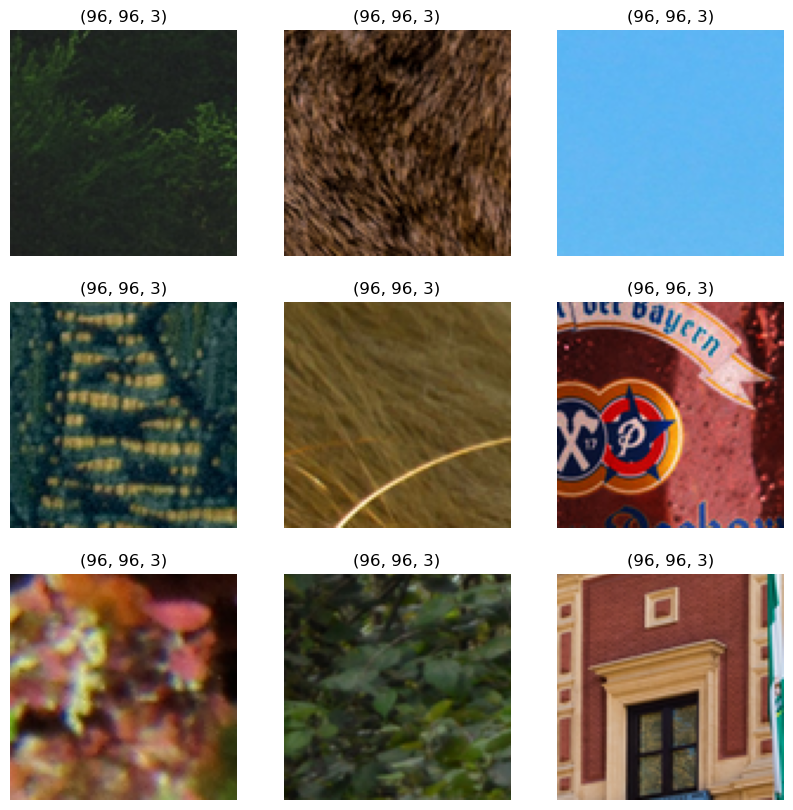

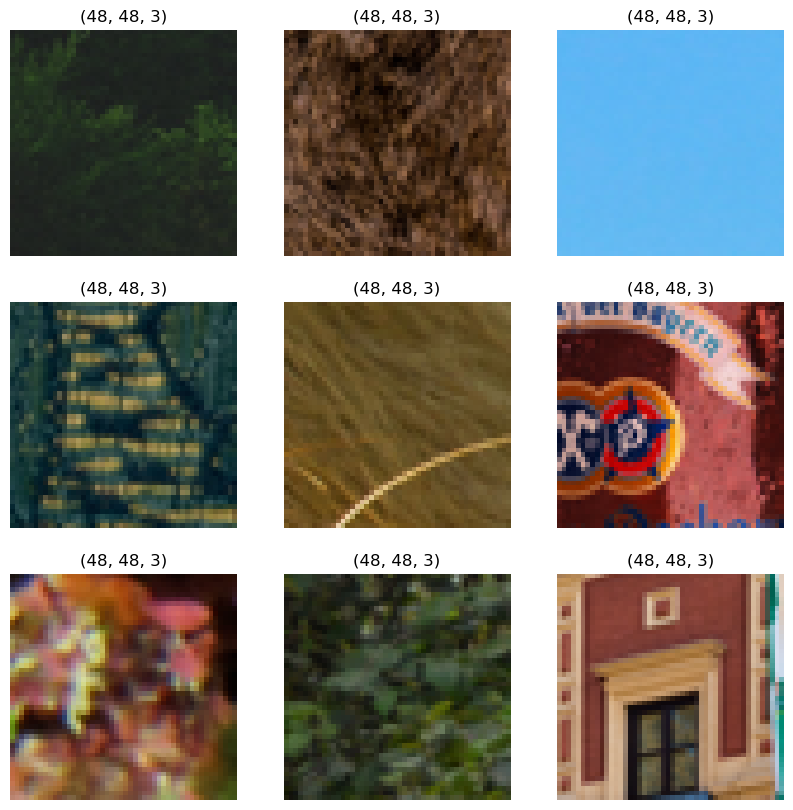

In [23]:
# Taking a look at the generated images

lowres, highres = next(iter(train_data_cropped))

# High Resolution Images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(highres[i].numpy().astype("uint8"))
    plt.title(highres[i].shape)
    plt.axis("off")

# Low Resolution Images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(lowres[i].numpy().astype("uint8"))
    plt.title(lowres[i].shape)
    plt.axis("off")

In [20]:
# Creating model

model_2x = create_model(num_filters=64, num_of_residual_blocks=16, upscale_factor=scale)  # upscale_factor needs to be a power of 2
model_2x.summary()

# Compiling model with loss as mean absolute error (L1 Loss) and metric as psnr (peak signal-to-noise ratio)
model_2x.compile(optimizer=optim_edsr, loss="mae", metrics=[PSNR])

# Training for more epochs will improve results
model_2x.fit(train_data_cropped, epochs=100, steps_per_epoch=200, validation_data=validation_data_cropped)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 rescaling_2 (Rescaling)        (None, None, None,   0           ['input_2[0][0]']                
                                3)                                                                
                                                                                                  
 conv2d_38 (Conv2D)             (None, None, None,   1792        ['rescaling_2[0][0]']            
                                64)                                                         

In [21]:
# Saving the model

model_2x.save("EDSR_2x.tf")


INFO:tensorflow:Assets written to: EDSR_2x.tf/assets


INFO:tensorflow:Assets written to: EDSR_2x.tf/assets


1/1 [==============================] - 2s 2s/step


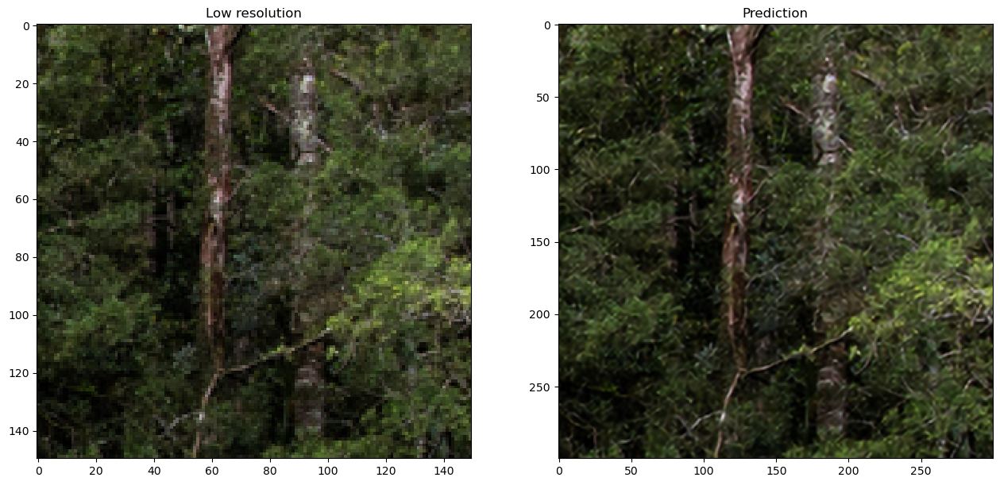

1/1 [==============================] - 1s 572ms/step


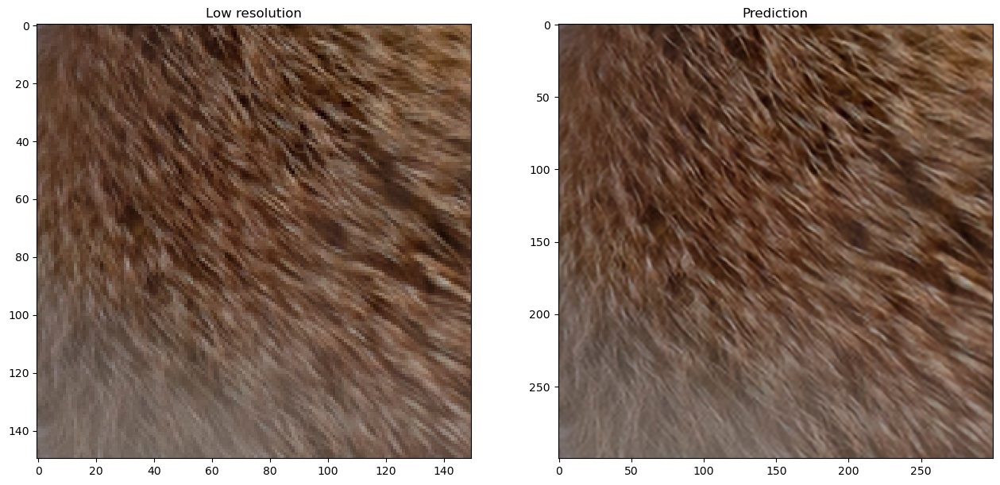

1/1 [==============================] - 1s 568ms/step


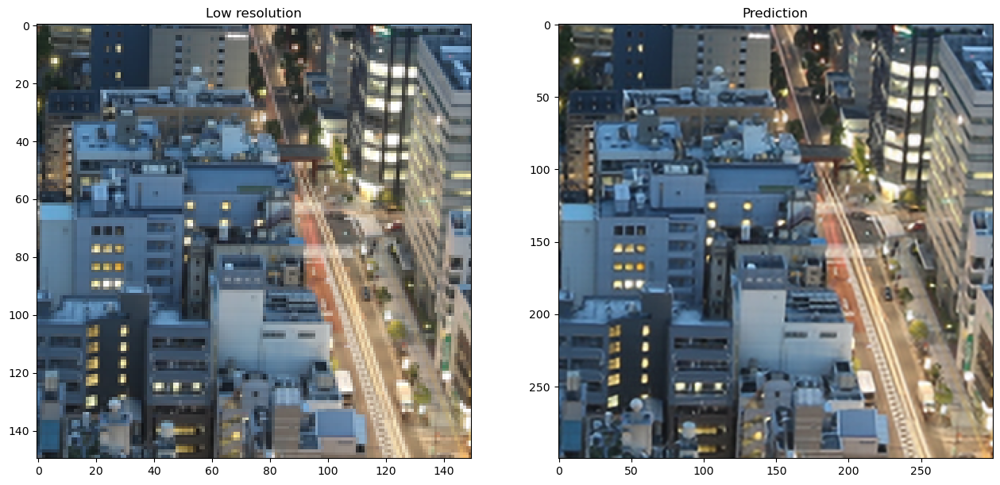

1/1 [==============================] - 1s 584ms/step


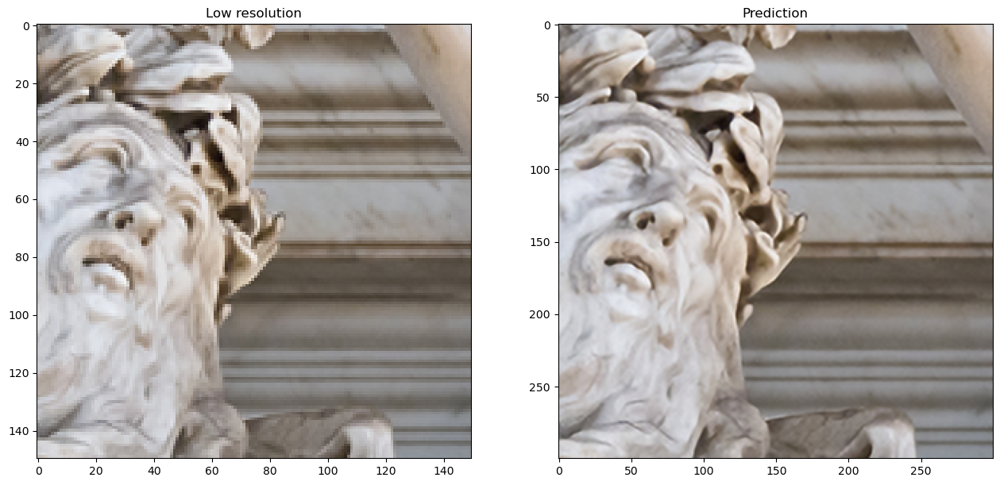

1/1 [==============================] - 1s 576ms/step


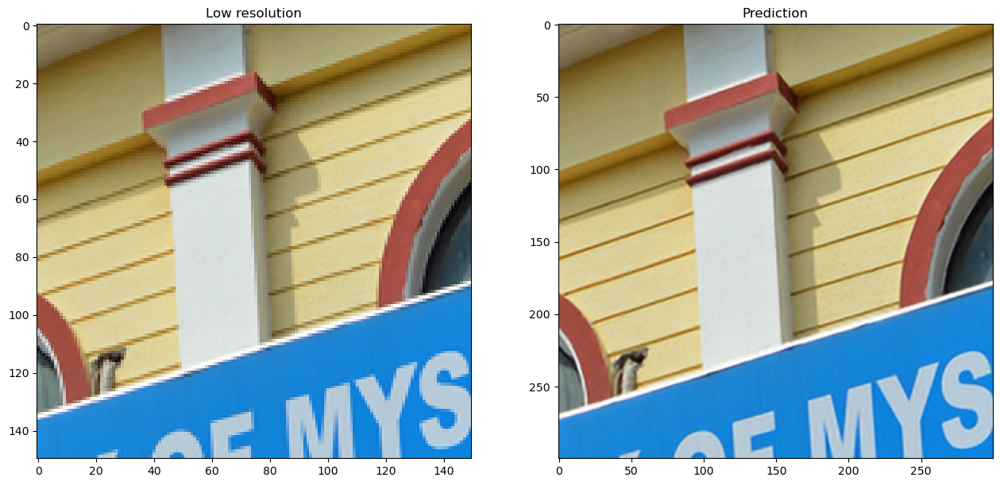

1/1 [==============================] - 1s 626ms/step


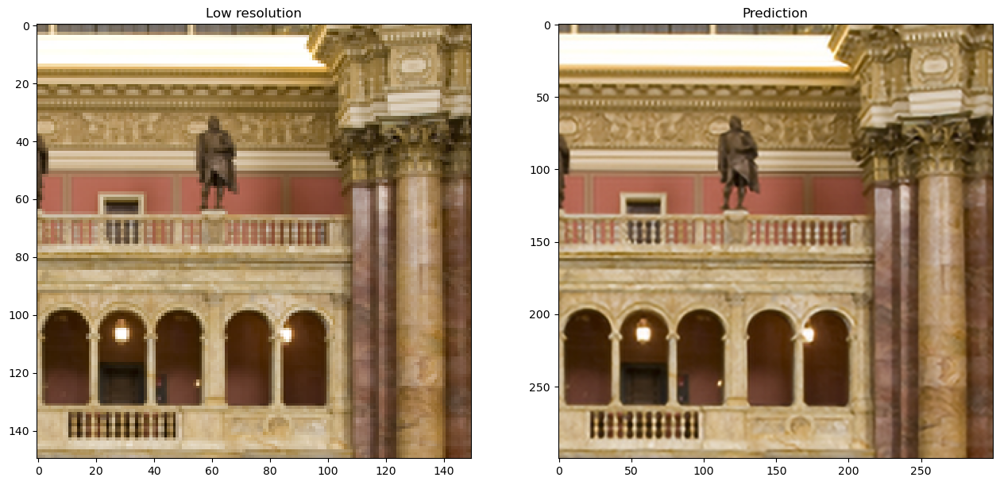

1/1 [==============================] - 1s 572ms/step


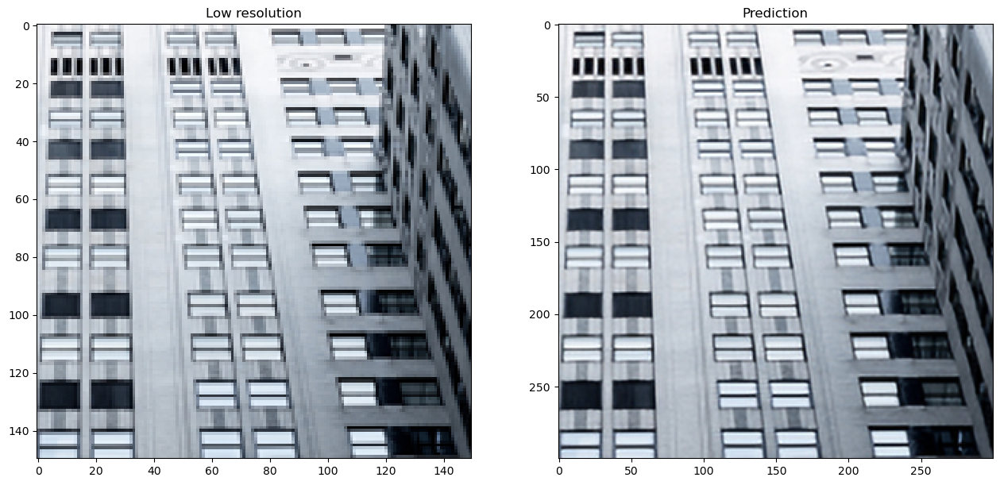

1/1 [==============================] - 1s 620ms/step


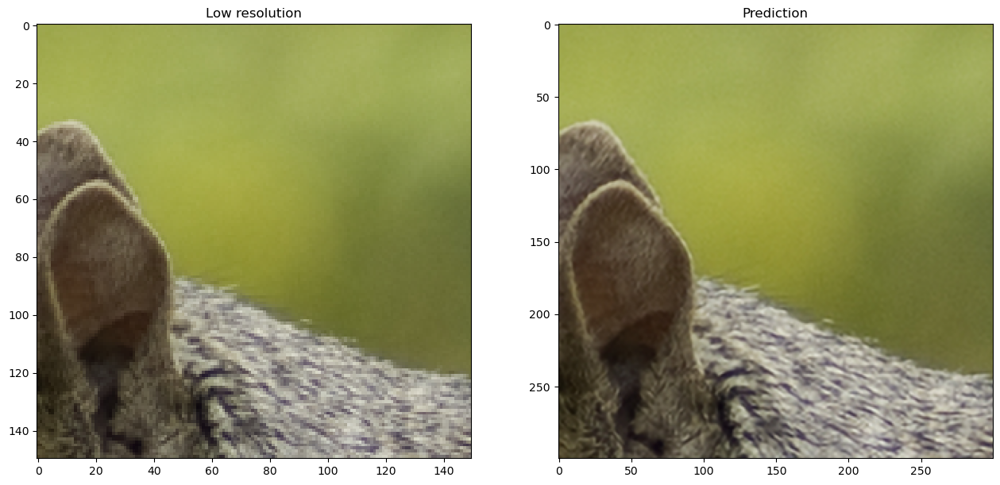

1/1 [==============================] - 1s 505ms/step


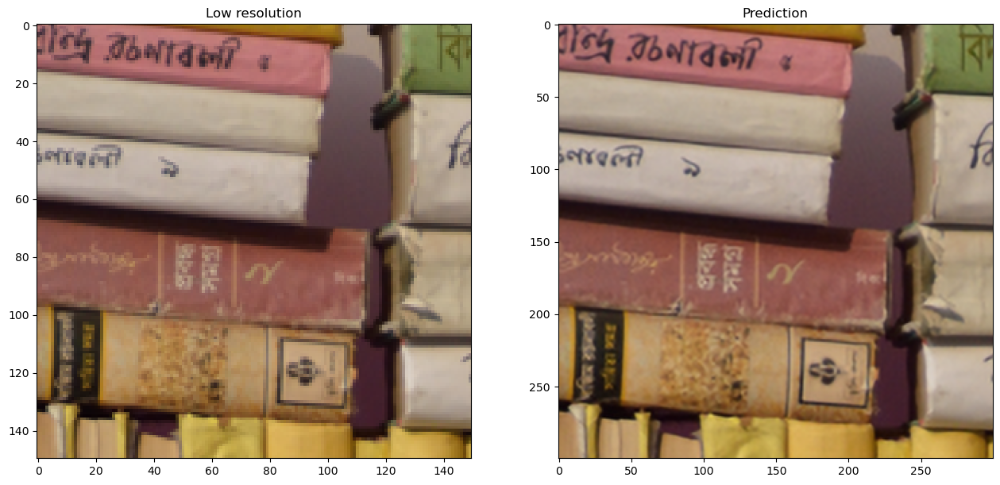

1/1 [==============================] - 1s 529ms/step


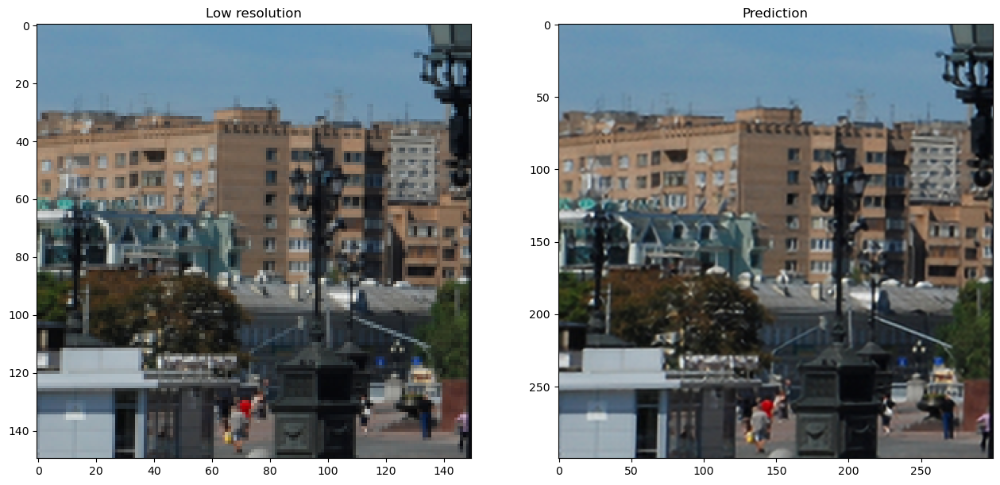

In [22]:
# Validating model

def plot_results(lowres, preds):
    """
    Displays low resolution image and super resolution image
    """
    plt.figure(figsize=(24, 14))
    plt.subplot(132), plt.imshow(lowres), plt.title("Low resolution")
    plt.subplot(133), plt.imshow(preds), plt.title("Prediction")
    plt.show()

def predict_step(model, x):
    """
    Predicts the high resolution image from the low resolution image 
    """

    # Adding dummy dimension using tf.expand_dims and converting to float32 using tf.cast
    # This step is necessary because the model was trained with 4D tensors (batch, height, width, color)
    x = tf.cast(tf.expand_dims(x, axis=0), tf.float32)
    # Passing low resolution image to model
    super_resolution_img = model.predict(x)
    # Clips the tensor from min(0) to max(255)
    # If the RGB code is below 0 or above 255, it will be set as 0 or 255, respectively 
    super_resolution_img = tf.clip_by_value(super_resolution_img, 0, 255)
    # Rounds the values of a tensor to the nearest integer, because RGB codes are integers
    super_resolution_img = tf.round(super_resolution_img)
    # Removes dimensions of size 1 from the shape of a tensor (to remove the dummy dimension) and converts to uint8
    super_resolution_img = tf.squeeze(
        tf.cast(super_resolution_img, tf.uint8), axis=0)
    return super_resolution_img

for lowres, highres in validation_data.take(10):
    # The image is cropped so that the effect is clearer
    lowres = tf.image.random_crop(lowres, (150, 150, 3))
    preds = predict_step(model_2x,lowres)
    plot_results(lowres, preds)

## Training Model with x4 Upscaling

In [13]:
# Download DIV2K bicubic_x4 from TF Datasets

# Using bicubic x4 degradation type
div2k_data = tfds.builder('div2k', config = 'bicubic_x4')
div2k_data.download_and_prepare()

# Taking train data from div2k_data object
train_data = div2k_data.as_dataset(split="train",
                                   as_supervised=True # outputs a 2-tuple structure (low resolution image, high resolution image)
                                   )


# Taking validation data div2k_data object
validation_data = div2k_data.as_dataset(split="validation",
                                        as_supervised=True # outputs a 2-tuple structure (low resolution image, high resolution image)
                                        )



In [14]:
# Defining training and validation data

scale = 4

train_data_cropped = dataset_object(train_data, scale, training=True)
validation_data_cropped = dataset_object(validation_data, scale, training=False)

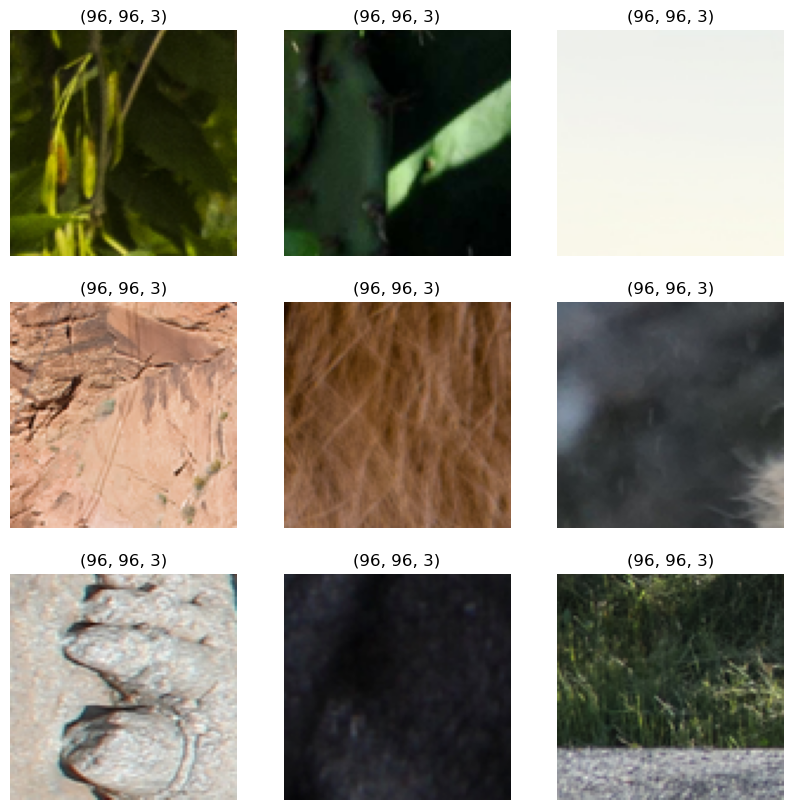

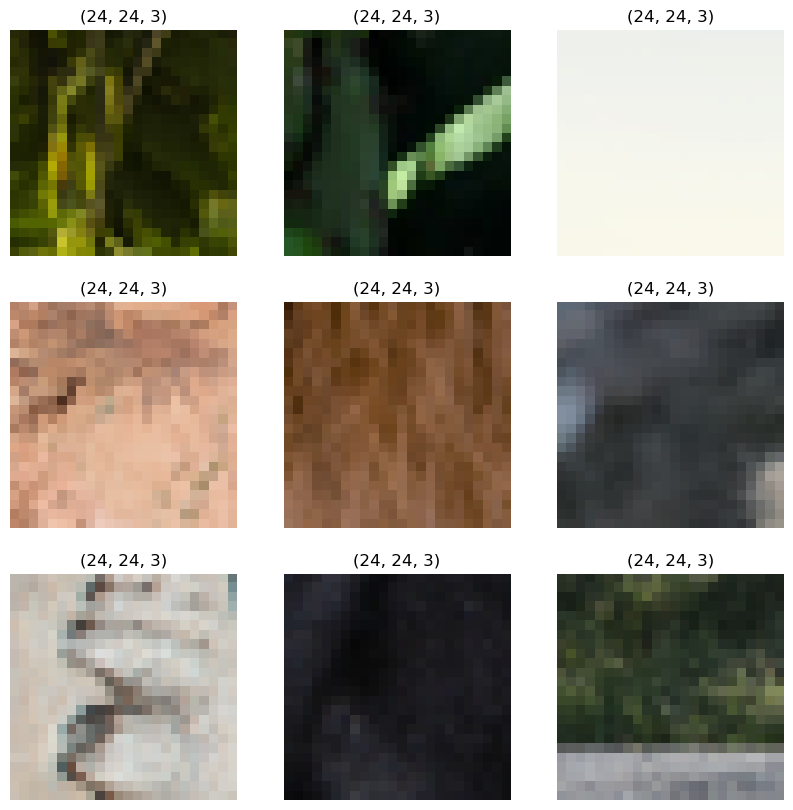

In [15]:
# Taking a look at the generated images

lowres, highres = next(iter(train_data_cropped))

# High Resolution Images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(highres[i].numpy().astype("uint8"))
    plt.title(highres[i].shape)
    plt.axis("off")

# Low Resolution Images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(lowres[i].numpy().astype("uint8"))
    plt.title(lowres[i].shape)
    plt.axis("off")

In [16]:
# Creating the model

model_4x = create_model(num_filters=64, num_of_residual_blocks=16, upscale_factor=scale)  # upscale_factor needs to be a power of 2
model_4x.summary()

# Compiling model with loss as mean absolute error (L1 Loss) and metric as psnr (peak signal-to-noise ratio)
model_4x.compile(optimizer=optim_edsr, loss="mae", metrics=[PSNR])

# Training for more epochs will improve results
model_4x.fit(train_data_cropped, epochs=100, steps_per_epoch=200, validation_data=validation_data_cropped)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 rescaling (Rescaling)          (None, None, None,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   1792        ['rescaling[0][0]']              
                                64)                                                           

In [17]:
# Saving the model

model_4x.save("EDSR_4x.tf")


INFO:tensorflow:Assets written to: EDSR_4x.tf/assets


INFO:tensorflow:Assets written to: EDSR_4x.tf/assets


1/1 [==============================] - 1s 1s/step


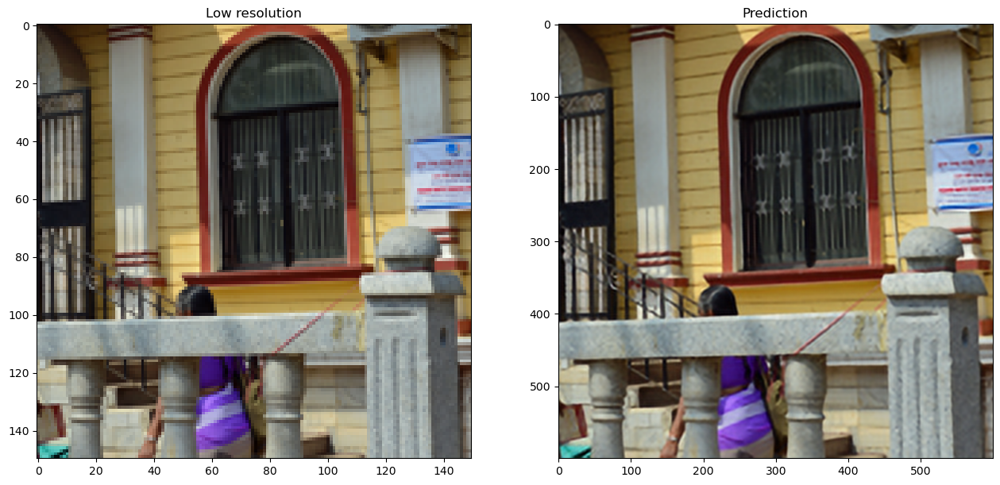

1/1 [==============================] - 1s 883ms/step


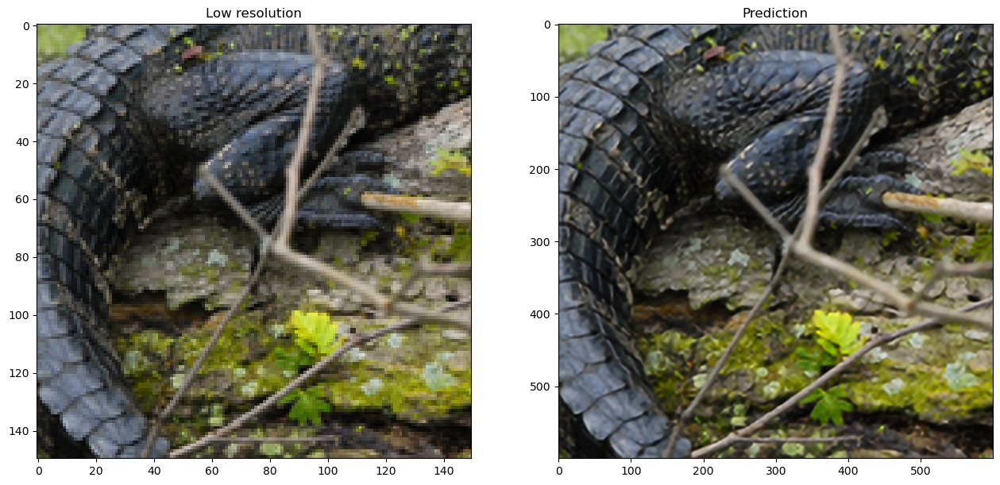

1/1 [==============================] - 1s 912ms/step


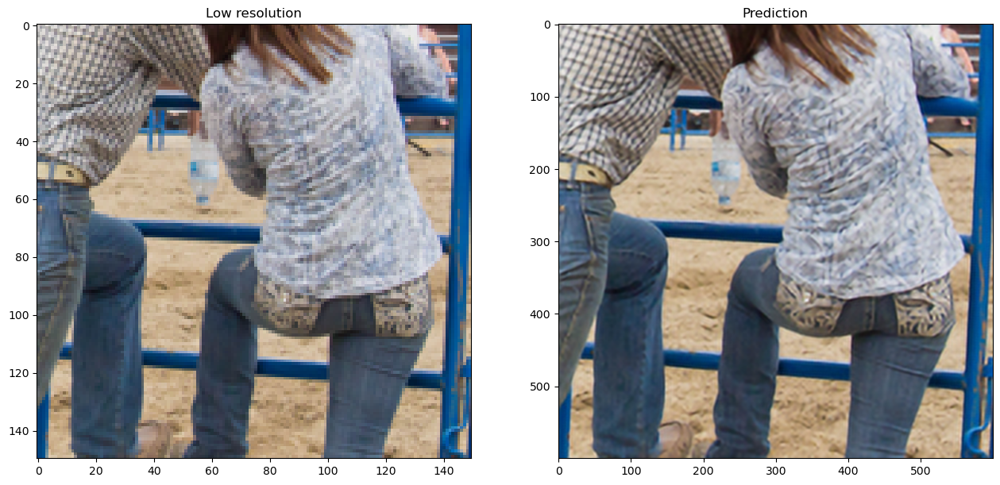

1/1 [==============================] - 1s 749ms/step


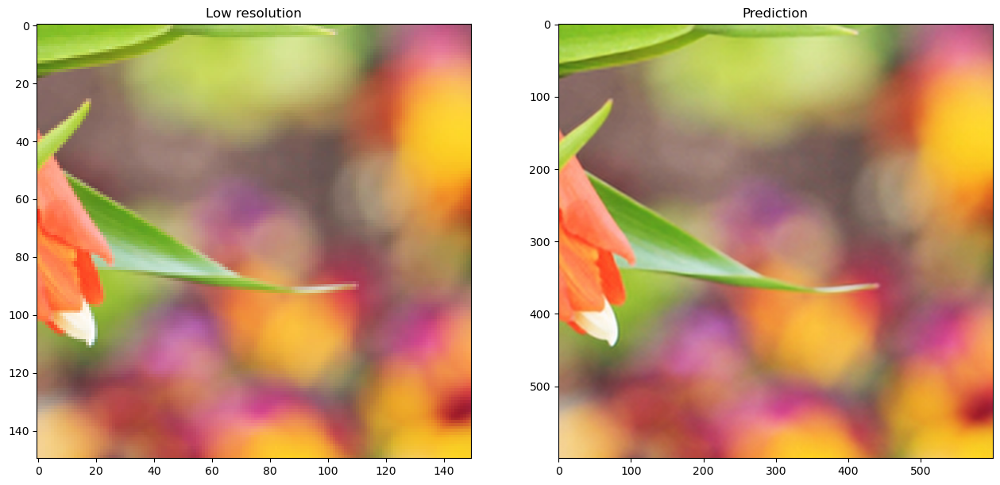

1/1 [==============================] - 1s 973ms/step


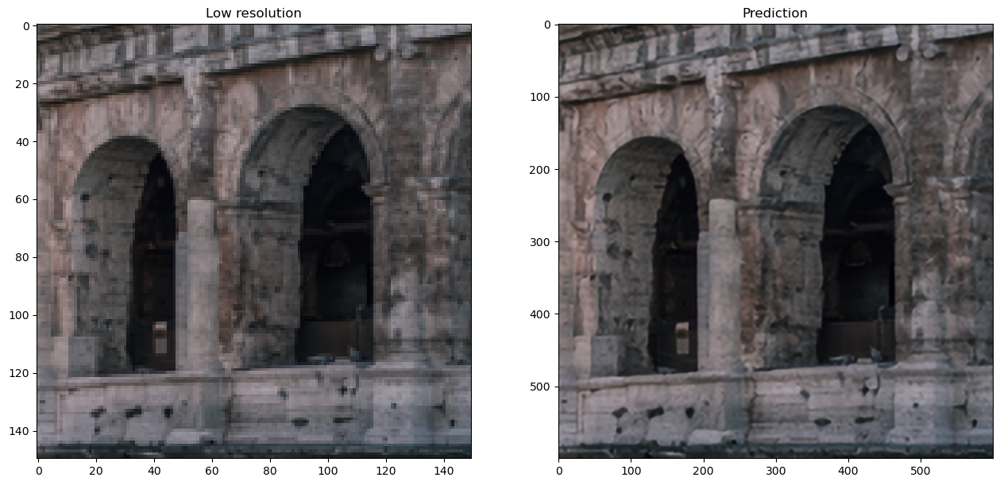

1/1 [==============================] - 1s 803ms/step


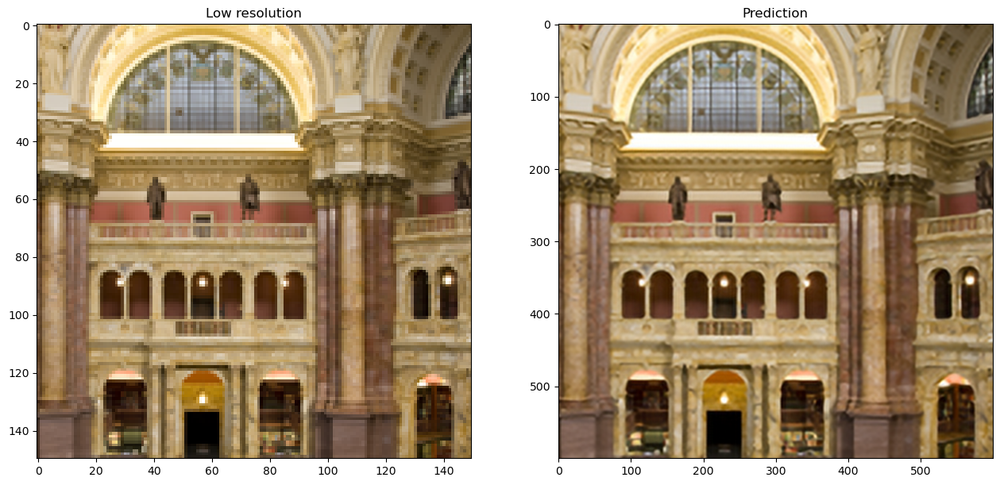

1/1 [==============================] - 1s 825ms/step


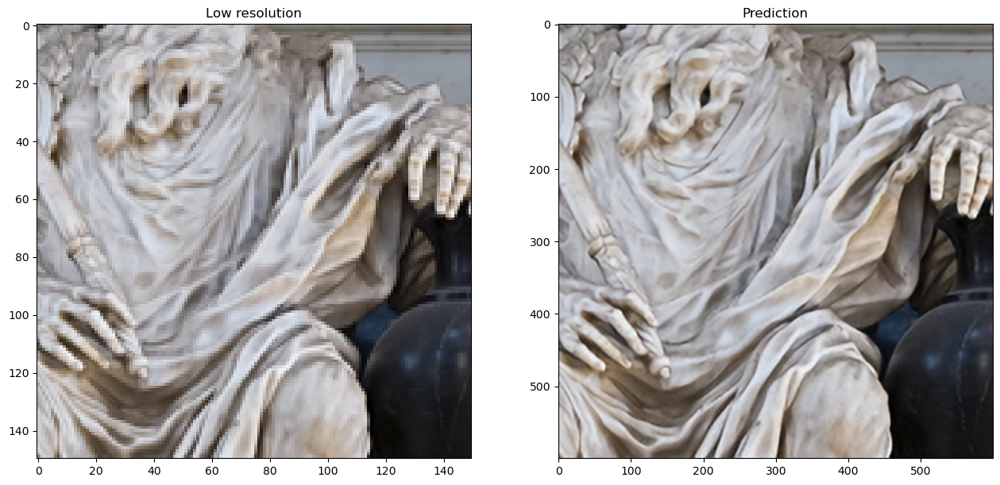

1/1 [==============================] - 1s 713ms/step


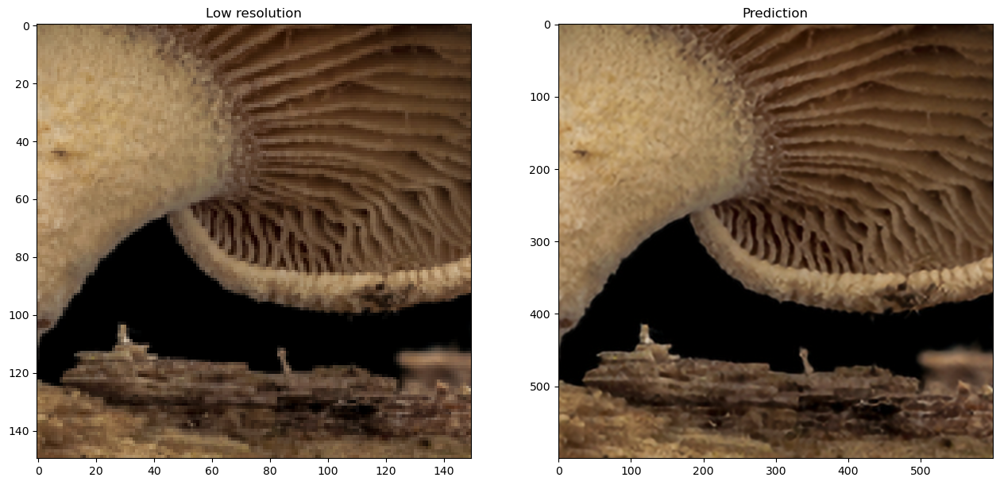

1/1 [==============================] - 1s 766ms/step


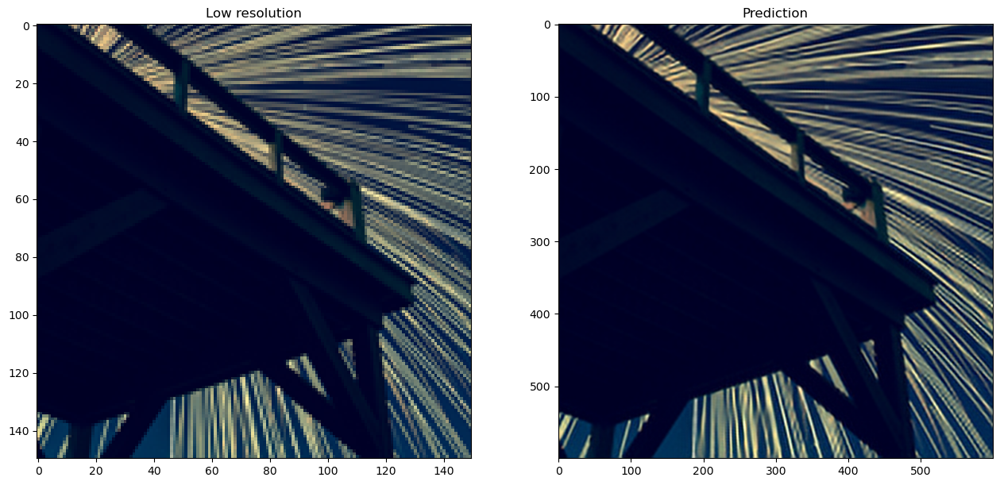

1/1 [==============================] - 1s 801ms/step


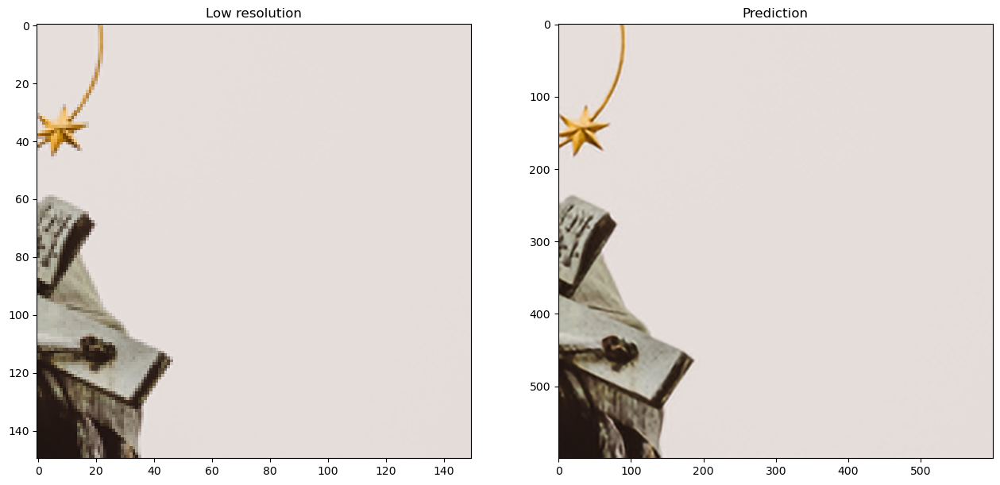

In [19]:
# Validating the model

def plot_results(lowres, preds):
    """
    Displays low resolution image and super resolution image
    """
    plt.figure(figsize=(24, 14))
    plt.subplot(132), plt.imshow(lowres), plt.title("Low resolution")
    plt.subplot(133), plt.imshow(preds), plt.title("Prediction")
    plt.show()

def predict_step(model, x):
    """
    Predicts the high resolution image from the low resolution image 
    """

    # Adding dummy dimension using tf.expand_dims and converting to float32 using tf.cast
    # This step is necessary because the model was trained with 4D tensors (batch, height, width, color)
    x = tf.cast(tf.expand_dims(x, axis=0), tf.float32)
    # Passing low resolution image to model
    super_resolution_img = model.predict(x)
    # Clips the tensor from min(0) to max(255)
    # If the RGB code is below 0 or above 255, it will be set as 0 or 255, respectively 
    super_resolution_img = tf.clip_by_value(super_resolution_img, 0, 255)
    # Rounds the values of a tensor to the nearest integer, because RGB codes are integers
    super_resolution_img = tf.round(super_resolution_img)
    # Removes dimensions of size 1 from the shape of a tensor (to remove the dummy dimension) and converts to uint8
    super_resolution_img = tf.squeeze(
        tf.cast(super_resolution_img, tf.uint8), axis=0)
    return super_resolution_img

for lowres, highres in validation_data.take(10):
    # The image is cropped so that the effect is clearer
    lowres = tf.image.random_crop(lowres, (150, 150, 3))
    preds = predict_step(model_4x,lowres)
    plot_results(lowres, preds)

## Training Model with x8 Upscaling

In [8]:
# Download DIV2K bicubic_x8 from TF Datasets

# Using bicubic x8 degradation type
div2k_data = tfds.builder('div2k', config = 'bicubic_x8')
div2k_data.download_and_prepare()

# Taking train data from div2k_data object
train_data = div2k_data.as_dataset(split="train",
                                   as_supervised=True # outputs a 2-tuple structure (low resolution image, high resolution image)
                                   )


# Taking validation data div2k_data object
validation_data = div2k_data.as_dataset(split="validation",
                                        as_supervised=True # outputs a 2-tuple structure (low resolution image, high resolution image)
                                        )



In [9]:
# Defining training and validation data

scale = 8

train_data_cropped = dataset_object(train_data, scale, training=True)
validation_data_cropped = dataset_object(validation_data, scale, training=False)

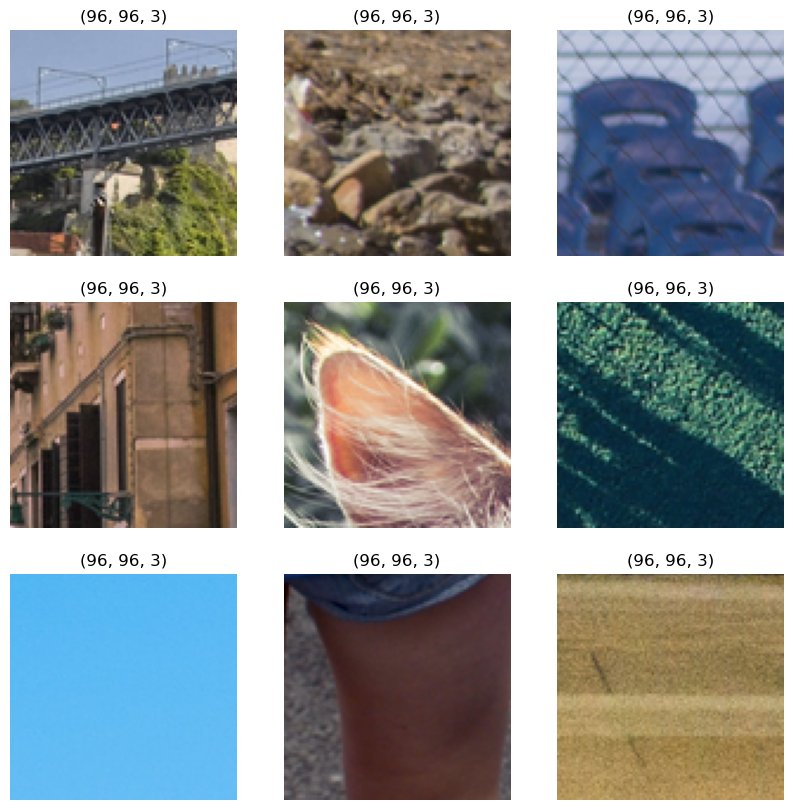

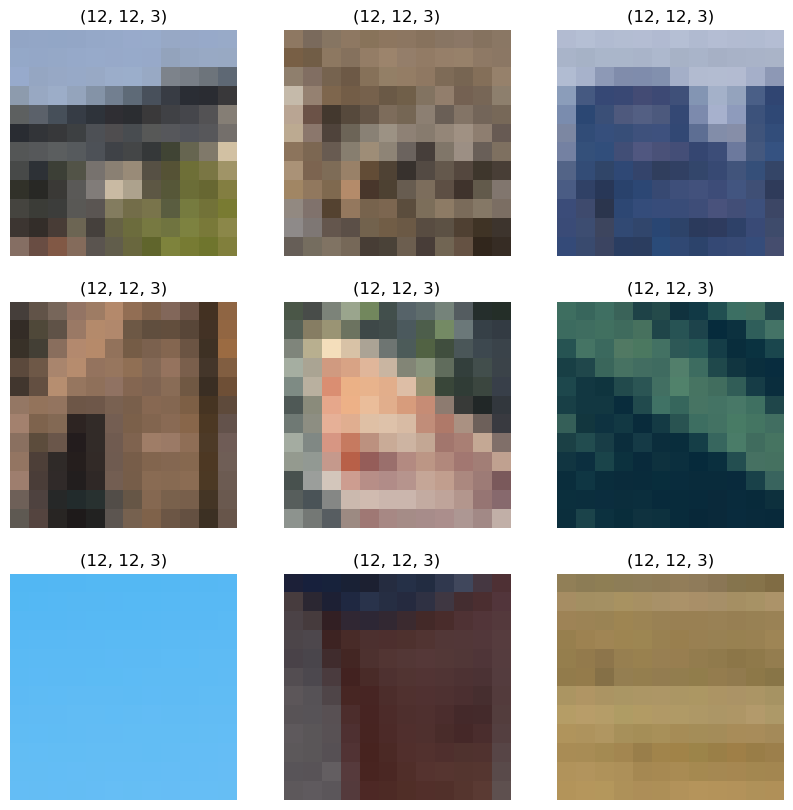

In [10]:
# Taking a look at the generated images

lowres, highres = next(iter(train_data_cropped))

# High Resolution Images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(highres[i].numpy().astype("uint8"))
    plt.title(highres[i].shape)
    plt.axis("off")

# Low Resolution Images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(lowres[i].numpy().astype("uint8"))
    plt.title(lowres[i].shape)
    plt.axis("off")

In [11]:
# Creating the model

model_8x = create_model(num_filters=64, num_of_residual_blocks=16, upscale_factor=scale)  # upscale_factor needs to be a power of 2
model_8x.summary()

# Compiling model with loss as mean absolute error (L1 Loss) and metric as psnr (peak signal-to-noise ratio)
model_8x.compile(optimizer=optim_edsr, loss="mae", metrics=[PSNR])

# Training for more epochs will improve results
model_8x.fit(train_data_cropped, epochs=100, steps_per_epoch=200, validation_data=validation_data_cropped)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 rescaling (Rescaling)          (None, None, None,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   1792        ['rescaling[0][0]']              
                                64)                                                           

In [12]:
# Saving the model

model_8x.save("EDSR_8x.tf")


INFO:tensorflow:Assets written to: EDSR_8x.tf/assets


INFO:tensorflow:Assets written to: EDSR_8x.tf/assets


1/1 [==============================] - 3s 3s/step


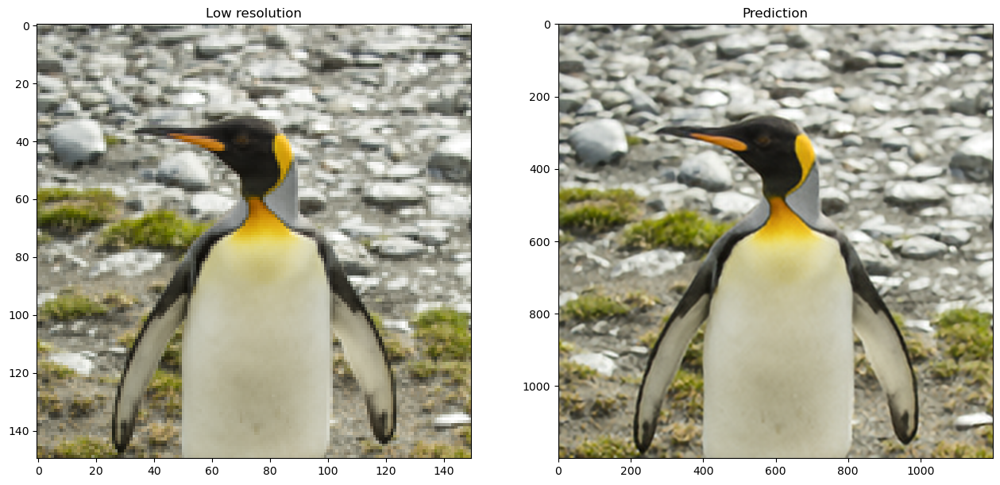

1/1 [==============================] - 2s 2s/step


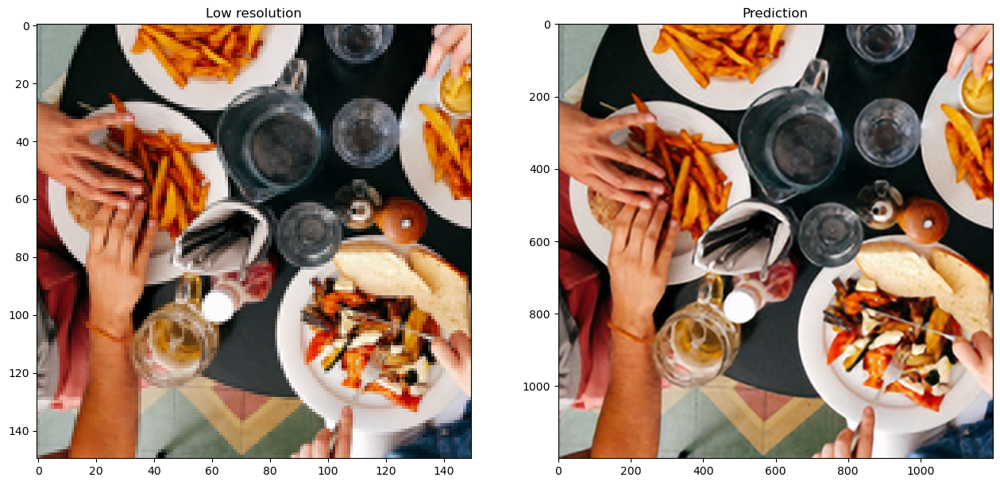

1/1 [==============================] - 2s 2s/step


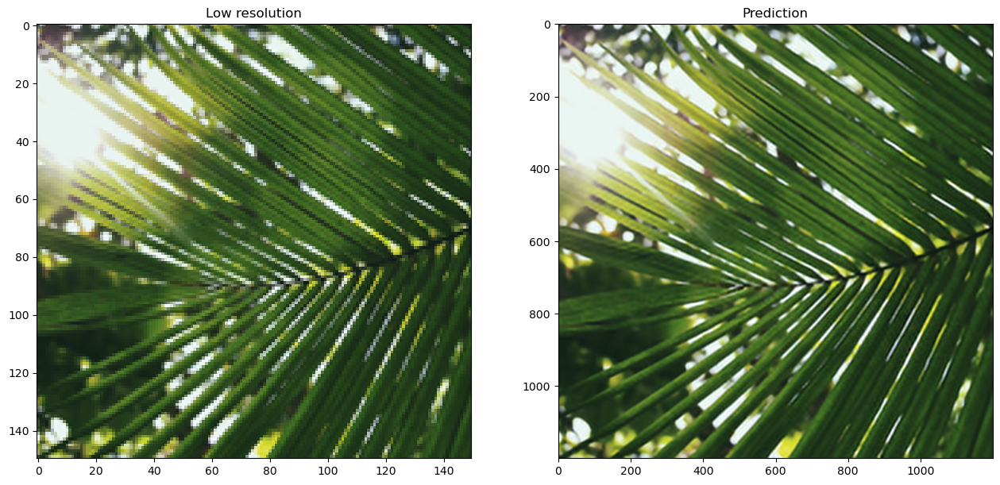

1/1 [==============================] - 2s 2s/step


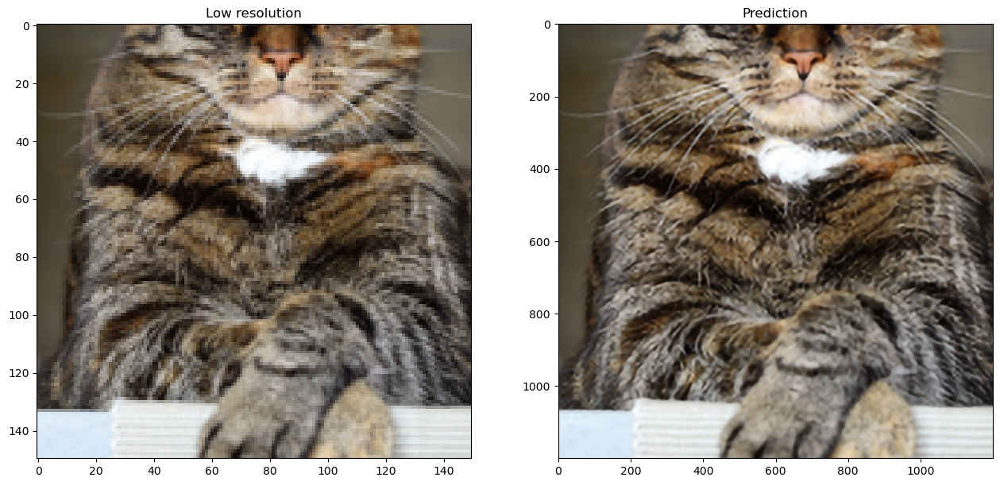

1/1 [==============================] - 2s 2s/step


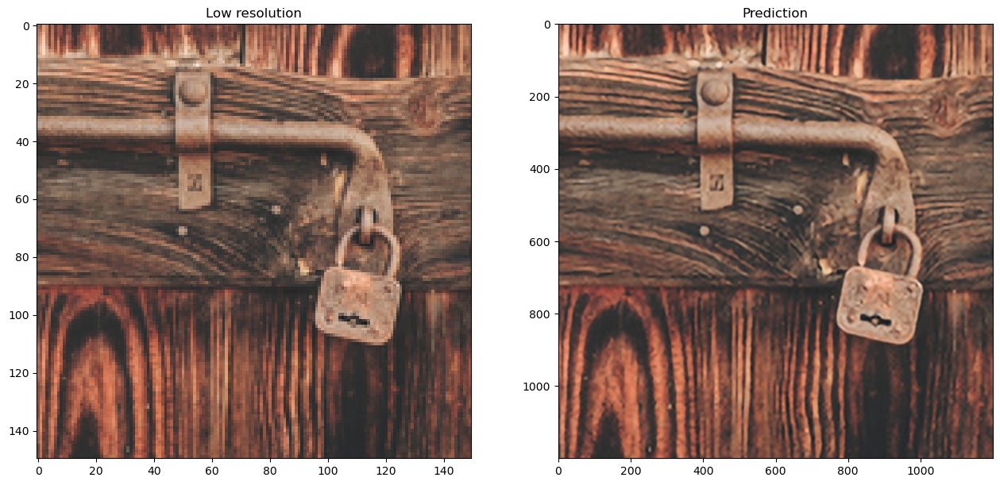

1/1 [==============================] - 2s 2s/step


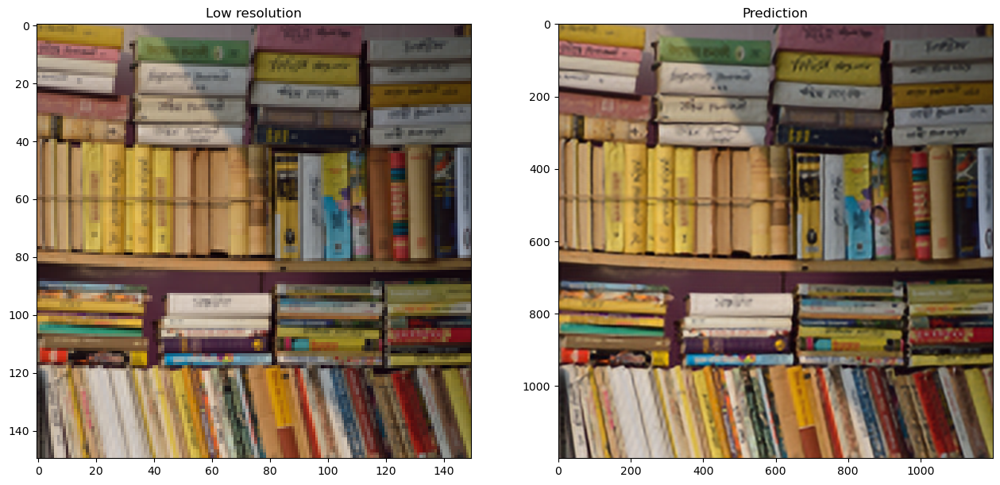

1/1 [==============================] - 2s 2s/step


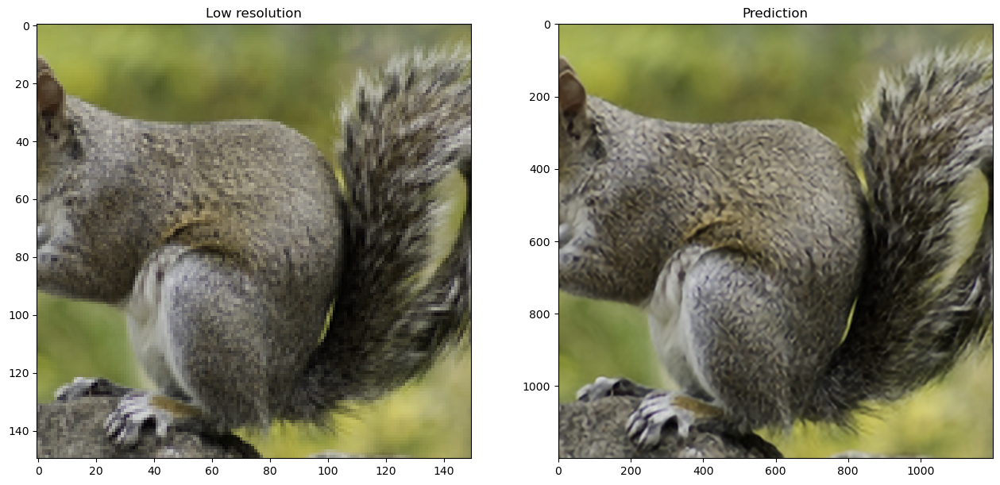

1/1 [==============================] - 2s 2s/step


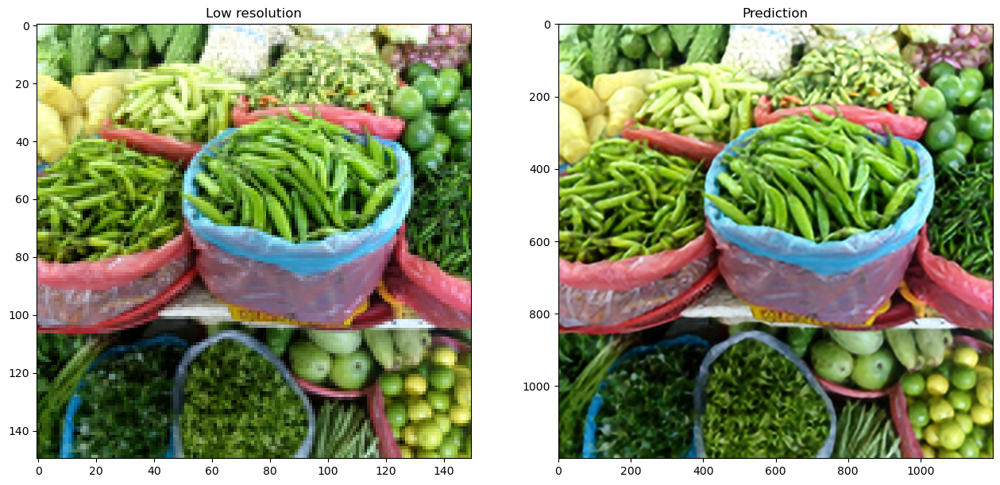

1/1 [==============================] - 2s 2s/step


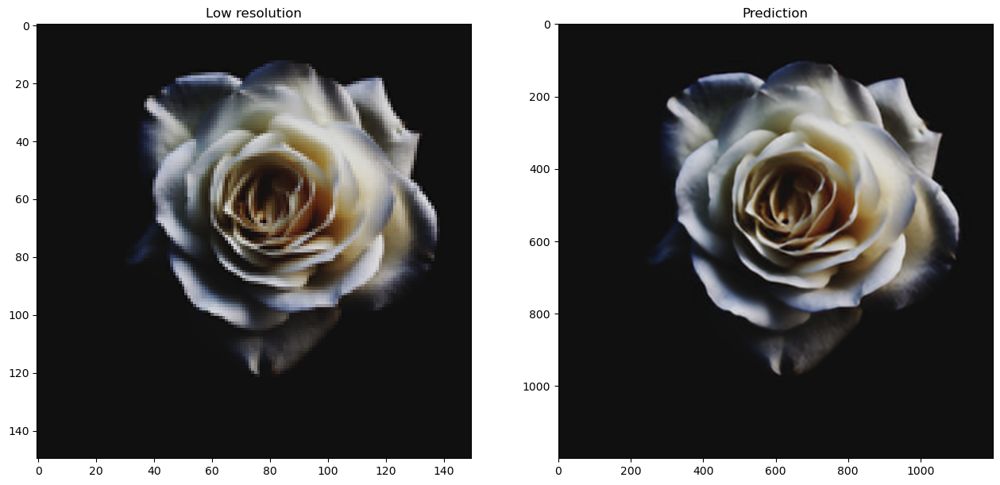

1/1 [==============================] - 2s 2s/step


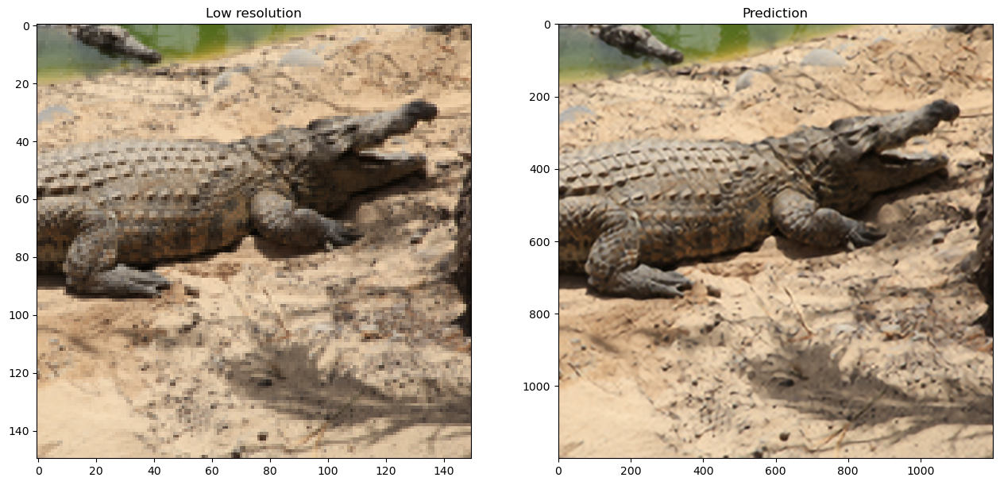

In [7]:
# Validating the model

def plot_results(lowres, preds):
    """
    Displays low resolution image and super resolution image
    """
    plt.figure(figsize=(24, 14))
    plt.subplot(132), plt.imshow(lowres), plt.title("Low resolution")
    plt.subplot(133), plt.imshow(preds), plt.title("Prediction")
    plt.show()

def predict_step(model, x):
    """
    Predicts the high resolution image from the low resolution image 
    """

    # Adding dummy dimension using tf.expand_dims and converting to float32 using tf.cast
    # This step is necessary because the model was trained with 4D tensors (batch, height, width, color)
    x = tf.cast(tf.expand_dims(x, axis=0), tf.float32)
    # Passing low resolution image to model
    super_resolution_img = model.predict(x)
    # Clips the tensor from min(0) to max(255)
    # If the RGB code is below 0 or above 255, it will be set as 0 or 255, respectively 
    super_resolution_img = tf.clip_by_value(super_resolution_img, 0, 255)
    # Rounds the values of a tensor to the nearest integer, because RGB codes are integers
    super_resolution_img = tf.round(super_resolution_img)
    # Removes dimensions of size 1 from the shape of a tensor (to remove the dummy dimension) and converts to uint8
    super_resolution_img = tf.squeeze(
        tf.cast(super_resolution_img, tf.uint8), axis=0)
    return super_resolution_img

for lowres, highres in validation_data.take(10):
    # The image is cropped so that the effect is clearer
    lowres = tf.image.random_crop(lowres, (150, 150, 3))
    preds = predict_step(model_8x,lowres)
    plot_results(lowres, preds)
    